In [2]:
using DifferentialEquations
include("src/Utils.jl")
include("src/Models.jl")
include("src/Params.jl");
using Plots; pythonplot();
using Statistics
using Contour
# import Pandas as pd

## Add KaiBC-KaiA binding equilibrium to the model

In [3]:
"""
At low temperatures kSU can be different from kSUB. See Axmann et al. 2004 Fig. 4 and Gopal's preliminary data
"""
function kaiabc_phong_low_temp3!(dX, X, p, t)

    # U: unphosphorylated. T: only T432 phosphorylated. S: only S431 phosphorylated
    # D: doubly phosphorylated. DB: D KaiC bound with KaiB. SB: S KaiC bound with KaiB
    U, T, D, S, DB, SB = X

    # k's are reaction constants (here all are 1st-order), e.g., 
    # kTU is the per reactant rate transfering from T to U
    # kCIhyd: ATP hydrolysis rate of the CI ring
    # KA: [KaiA] that activates kinase activity to half maximum
    # A0: initial [KaiA]
    # fATP = [ATP] / ([ATP] + [ADP])
    # N: # A sequestered per D. M: # A sequestered per S
    # note that this model does not include K_ASB
    kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU, kSUA, kUSA, kCIhyd,
    KA, A0, fATP, N, M, K_ASB, κ, ν = p

    hill(x) = x/(x + KA)

    # More realistic KaiA binding with a Kd
    # !!Ignored sequestration of KaiA by DB
    A = A0*(κ^ν/(κ^ν + (SB)^ν))    # free KaiA
    
    #           U,      T,      D,      S,      DB,     SB
    dephos_r  = [0      kTU     0       kSU     0       kSU
                 0      0       kDT     0       kDT     0
                 0      0       0       0       0       0
                 0      0       kDS     0       0       0
                 0      0       0       0       0       0
                 0      0       0       0       kDS     0] +
                [0      kTUA    0       kSUA    0       kSUA
                 0      0       kDTA    0       kDTA    0
                 0      0       0       0       0       0
                 0      0       kDSA    0       0       0
                 0      0       0       0       0       0
                 0      0       0       0       kDSA    0]*hill(A)
    
    #         U     T       D       S       DB      SB
    phos_r = [0     0       0       0       0       0
              kUTA  0       0       0       0       0
              0     kTDA    0       kSDA    0       0
              kUSA  0       0       0       0       0
              0     0       0       0       0       kSDA
              0     0       0       0       0       0]*hill(A)*fATP

    #        U      T       D       S       DB      SB
    hyd_r = [0      0       0       0       0       0
             0      0       0       0       0       0
             0      0       0       0       0       0
             0      0       0       0       0       0
             0      0       kCIhyd  0       0       0
             0      0       0       kCIhyd  0       0]

    r = dephos_r + phos_r + hyd_r

    # conservation
    r -= I(size(r)[1]) .* sum(r, dims=1)

    # (for AD) Zygote.Buffer doesn't support in-place broadcast .=
    # see https://discourse.julialang.org/t/how-to-use-initialize-zygote-buffer/87653
    dX[:] = r*X
    nothing
end

kaiabc_phong_low_temp3!

Check out the trajectories

In [16]:
A0 = 1.0
fATP = 1.0

kSU_cold = 0.1
# note that in this model, K_ASB has been eliminated
M_new = 6
κ = 0.1
ν = 9

p_ori = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU, kSUA, kUSA, kCIhyd,
KA, A0, fATP, N, M);

p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_cold, kSUA, kUSA, kCIhyd,
KA, A0, fATP, 0., M_new, κ, ν);

┌ Warning: First function call produced NaNs. Exiting. Double check that none of the initial conditions, parameters, or timespan values are NaN.
└ @ OrdinaryDiffEq C:\Users\yoohy\.julia\packages\OrdinaryDiffEq\Knuk0\src\initdt.jl:131
┌ Warning: At t=0.0, dt was forced below floating point epsilon 5.0e-324, and step error estimate = 1.0. Aborting. There is either an error in your model specification or the true solution is unstable (or the true solution can not be represented in the precision of Float64).
└ @ SciMLBase C:\Users\yoohy\.julia\packages\SciMLBase\sakPO\src\integrator_interface.jl:633


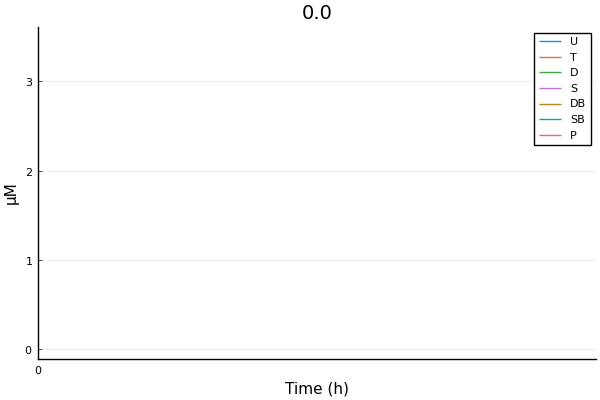

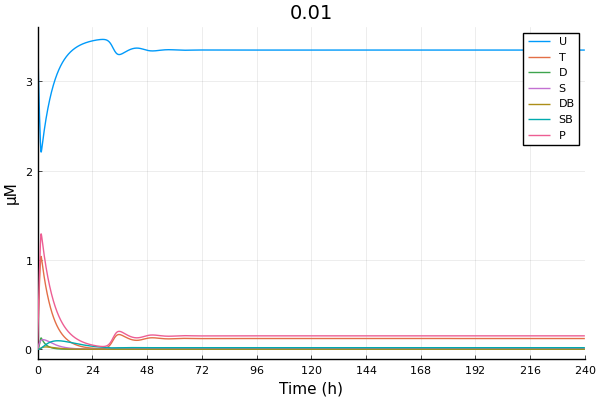

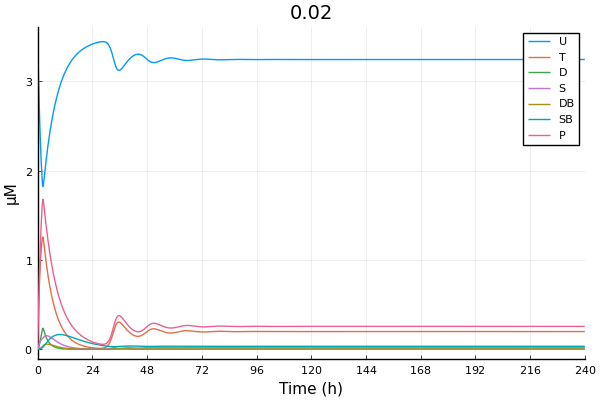

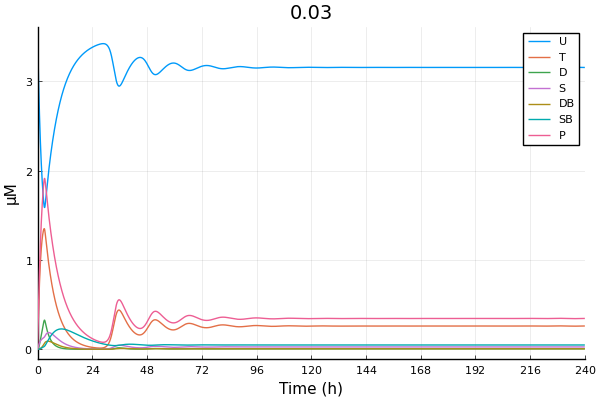

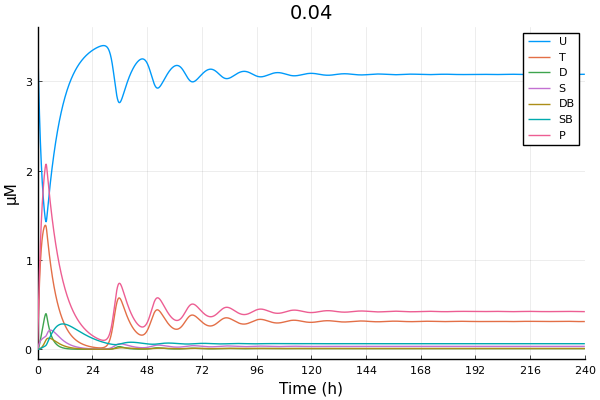

...

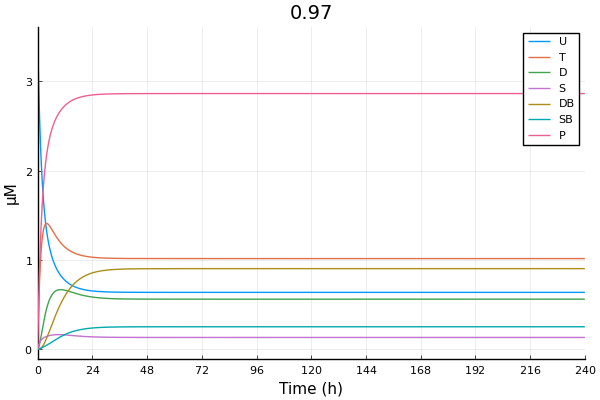

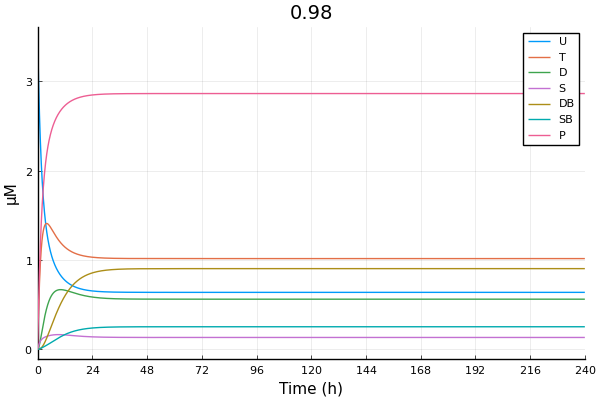

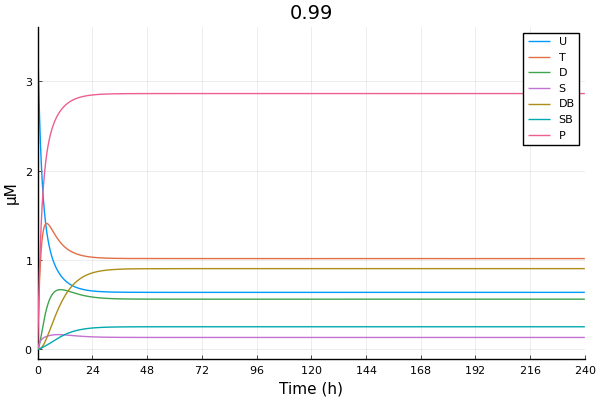

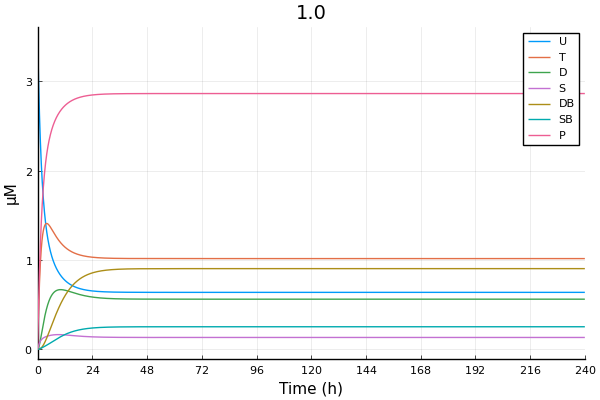

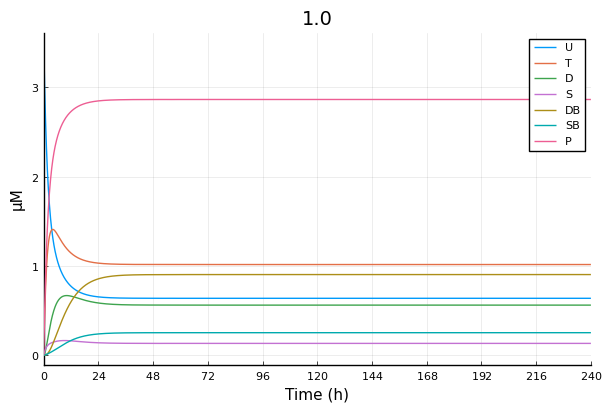

In [9]:
A0 = 1.0
fATP = 1.0

kSU_cold = 0.1
M_new = 2.

for i in 0:0.01:1
        κ = i
        ν = 9

        p_ori = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU, kSUA, kUSA, kCIhyd,
        KA, A0, fATP, N, M);

        p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_cold, kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, κ, ν);
        
        # U, T, D, S, DB, SB
        p0 = [3.5, 0, 0, 0, 0, 0]

        tmax = 240

        prob = ODEProblem(kaiabc_phong_low_temp3!, p0, (0.0, tmax), p)
        sol = solve(prob, Tsit5(), saveat = 0.1)

        p = plot(title = i, sol, labels=["U" "T" "D" "S" "DB" "SB"])
        plot!(sol.t, 3.5*phospho_C(sol.u), label="P")
        xticks!(0:24:tmax)
        xlabel!("Time (h)")
        ylabel!("μM")
        display(p)
end

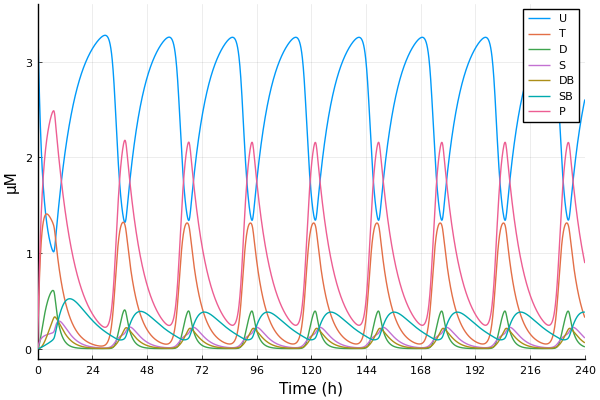

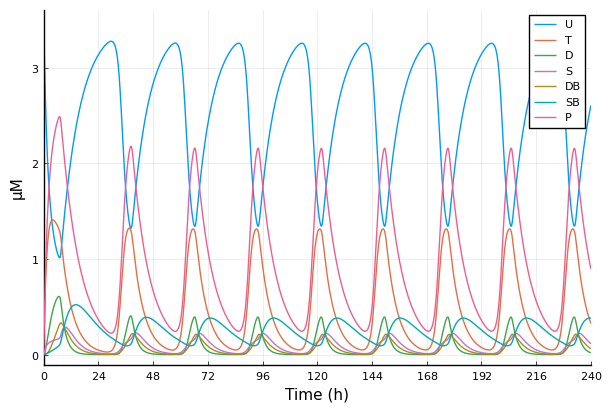

In [17]:
# U, T, D, S, DB, SB
p0 = [3.5, 0, 0, 0, 0, 0]

tmax = 240

prob = ODEProblem(kaiabc_phong_low_temp3!, p0, (0.0, tmax), p)
sol = solve(prob, Tsit5(), saveat = 0.1)

p = plot(sol, labels=["U" "T" "D" "S" "DB" "SB"])
plot!(sol.t, 3.5*phospho_C(sol.u), label="P")
xticks!(0:24:tmax)
xlabel!("Time (h)")
ylabel!("μM")
display(p)



$$
K_{ASB} = \frac{[\text{KaiA}]_{free}\cdot[\text{SB}]_{free}}{[(\text{KaiA})_M:\text{SB}]}
$$

Heatmap: checking out combinations of $k_{SU}$ and $K_{A:SB}$

In [13]:
κ = 0.06
ν = 9.

fATP = 1.
A0 = 1.

M_new = 6.
K_ASB = 0.1

u0 = [3.5, 0, 0, 0, 0, 0]
        
        p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, 0.03, kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_ASB, κ, ν)
        
        # solve it one more time to get mean fraction of pC
        prob = ODEProblem(kaiabc_phong_low_temp3!, u0, (0.0, 200), p)
        sol = solve(prob, Tsit5(), reltol=1e-8, abstol=1e-8)

conv_t, amplitude, per, phase = 
            attracted_to(kaiabc_phong_low_temp3!, u0, 168, p; 
            burnin=96, conv_tol=5e-2, amp_cutoff=5e-2, tmax_stop=1e3)

(0.016800000000000002, -1, -1, -1)

In [31]:
kSU_vec = 0.02:0.05:0.12
#κ_vec = 0.06:0.05:0.3
κ_vec = [0.06]

# additional params
A0 = 1.0
fATP = 1.0

# KaiBC-KaiA binding stoichiometry
M_new = 6.
ν = 9.
K_ASB = 0.1

# find period numerically
per_mat = zeros(length(kSU_vec), length(κ_vec))
amp_mat = zeros(length(kSU_vec), length(κ_vec))
pC_mat = zeros(length(kSU_vec), length(κ_vec))

for (i, kSU_cold) in enumerate(kSU_vec)
    for (j, κ) in enumerate(κ_vec)
        # initial conditions
        u0 = [3.5, 0, 0, 0, 0, 0]
        
        p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_cold, kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_ASB, κ, ν)

        println("κ = $(κ) ν = $(ν)")
        
        conv_t, amplitude, per, phase = 
            attracted_to(kaiabc_phong_low_temp3!, u0, 168, p; 
            burnin=96, conv_tol=5e-2, amp_cutoff=5e-2, tmax_stop=1e3)

        #=per_mat[i, j] = per == -1 ? NaN : per
        amp_mat[i, j] = amplitude == -1 ? NaN : amplitude
        
        # solve it one more time to get mean fraction of pC
        prob = ODEProblem(kaiabc_phong_low_temp3!, u0, (0.0, conv_t + 1000.), p)
        sol = solve(prob, reltol=1e-8, abstol=1e-8)
        mean_pC = conv_t < 0 ? NaN : mean(phospho_C(sol.u[sol.t .> conv_t]))
        
        pC_mat[i, j] = mean_pC
    
        print("kSU=$(kSU_cold); κ=$(κ); amp=$(amplitude); per=$(per); pC=$(mean_pC)\n")=#
    end
end

κ = 0.06 ν = 9.0


LoadError: UndefRefError: access to undefined reference

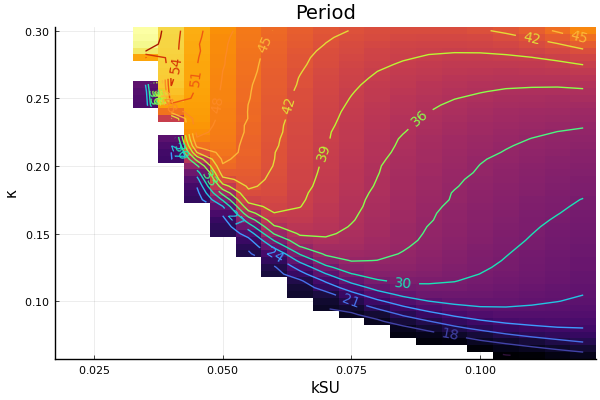

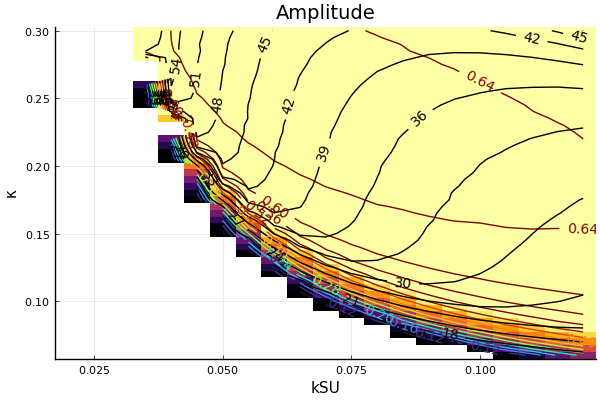

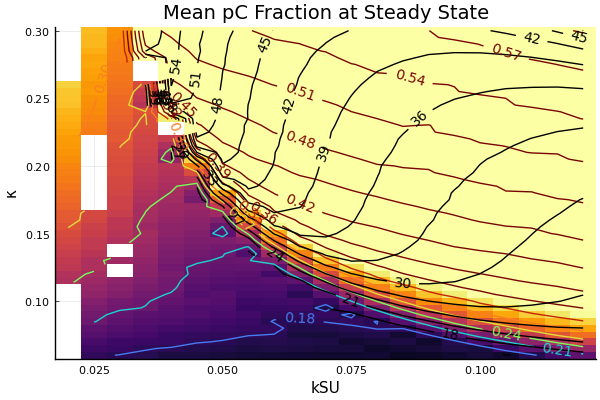

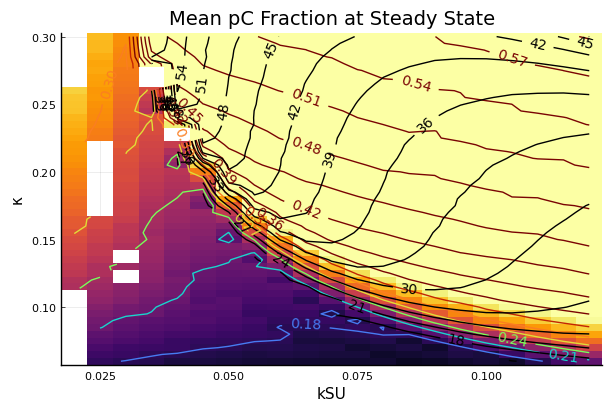

In [28]:
p1 = heatmap(kSU_vec, κ_vec, transpose(per_mat), xlabel="kSU", ylabel="κ", title = "Period")

contour!(p1, ones(length(κ_vec))*kSU_vec',
    κ_vec*ones(length(kSU_vec))', 
    transpose(per_mat), 
    levels=14, color=:turbo, clabels=true, cbar=false, lw=1)

display(p1)

p2 = heatmap(kSU_vec, κ_vec, transpose(amp_mat), xlabel="kSU", ylabel="κ", title = "Amplitude")

contour!(ones(length(κ_vec))*kSU_vec',
    κ_vec*ones(length(kSU_vec))', 
    transpose(amp_mat), 
    levels=14, color=:turbo, clabels=true, cbar=false,
    lw=1, clims=(0.1, 0.5))

contour!(p2, ones(length(κ_vec))*kSU_vec',
    κ_vec*ones(length(kSU_vec))', 
    transpose(per_mat), 
    levels=14, clabels=true, color=[:black], lw=1)

display(p2)

p3 = heatmap(kSU_vec, κ_vec, transpose(pC_mat), xlabel="kSU", ylabel="κ", title = "Mean pC Fraction at Steady State")

contour!(ones(length(κ_vec))*kSU_vec',
    κ_vec*ones(length(kSU_vec))', 
    transpose(pC_mat), 
    levels=14, color=:turbo, clabels=true, cbar=false, 
    lw=1, clims=(0.15, 0.35))

contour!(p3, ones(length(κ_vec))*kSU_vec',
    κ_vec*ones(length(kSU_vec))', 
    transpose(per_mat), 
    levels=14, clabels=true, color=[:black], lw=1)

display(p3)

Extract controur coordinates

In [29]:
using Contour

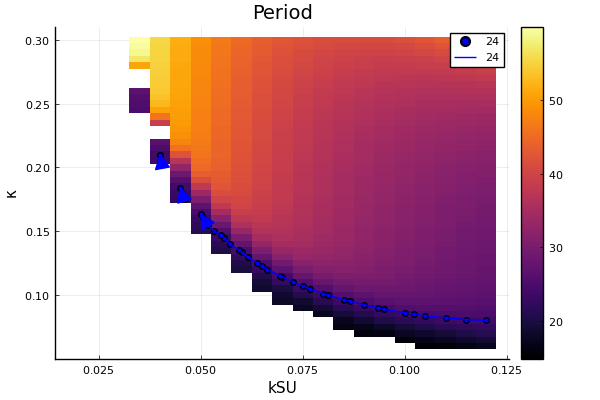

sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


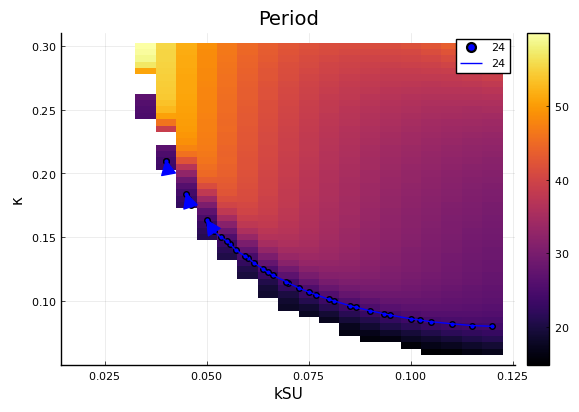

In [38]:
p4 = plot()
heatmap!(p4, kSU_vec, κ_vec, transpose(per_mat), xlabel="kSU", ylabel="κ", title = "Period")

cls = levels(contours(kSU_vec, κ_vec, per_mat, [24]))
isochrone = Dict()
cl = cls[1]
line = lines(cl)[1]

lvl = level(cl) # the z-value of this contour level
isochrone[lvl] = []

xs, ys = coordinates(line) # coordinates of this line segment
isochrone[lvl] = [isochrone[lvl]..., (xs, ys)]
scatter!(p4, xs, ys, label="$(lvl)", c=:blue) # pseuod-code; use whatever plotting package you prefer
plot!(p4, xs, ys, arrow=(:closed, 1.), label="$(lvl)", c=:blue)

display(p4)

In [39]:
# master parameters
M_new = 6.

# constants
tmax = 480
istart = 3001

p1 = plot(legend=false)
#p2 = plot(legendtitle="M")

kSU_24 = isochrone[24][1][1]
κ_24 = isochrone[24][1][2]

pal = palette(cgrad([:orange, :blue]), length(kSU_24))

for i in 1:2:length(kSU_24)
    
    if isnan(kSU_24[i]) || isnan(κ_24[i])
        continue
    end
    
    P0 = [3.5, 0, 0, 0, 0, 0]
    
    p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_24[i], kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_ASB, κ_24[i], ν)

    prob = ODEProblem(kaiabc_phong_low_temp3!, P0, (0.0, tmax), p)
    sol = solve(prob, Tsit5(), saveat = 0.1)

    pS = sum(hcat(sol.u...)[[3, 4, 5, 6], :], dims=1)
    #pS = sum(hcat(sol.u...)[[6], :], dims=1)
    pT = sum(hcat(sol.u...)[[2, 3, 5], :], dims=1)

    plot!(p1, pS'[istart:end], pT'[istart:end],c=pal[i])
    #plot!(p2, sol.t, hcat(sol.u...)[6, :], label="$(M_new)")
    
end

In [40]:
display(isochrone[24][1][2][5])
display(isochrone[24][1][1][5])

0.085

0.10228758485385162

In [41]:
# master parameters
M_new = 6.

# constants
tmax = 480
istart = 3001

p1 = plot(legend=false)
#p2 = plot(legendtitle="M")

kSU_24 = isochrone[24][1][1]
κ_24 = isochrone[24][1][2]

pal = palette(cgrad([:orange, :blue]), length(kSU_24))

# find period numerically
per_mat_after = zeros(length(kSU_24), 1)
amp_mat_after = zeros(length(kSU_24), 1)
pC_mat_after = zeros(length(kSU_24), 1)

for i in 1:length(kSU_24)
    if isnan(kSU_24[i]) || isnan(κ_24[i])
        continue
    end
        
        # initial conditions
        u0 = [3.5, 0, 0, 0, 0, 0]
    
        p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_24[i], kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_ASB, κ_24[i], ν)
        
        conv_t, amplitude, per, phase = 
            attracted_to(kaiabc_phong_low_temp3!, u0, 168, p; 
            burnin=96, conv_tol=5e-2, amp_cutoff=5e-2, tmax_stop=1e3)

        per_mat_after[i, 1] = per == -1 ? NaN : per
        amp_mat_after[i, 1] = amplitude == -1 ? NaN : amplitude
        
        println("kSU=$(kSU_24[i]); κ=$(κ_24[i]); amp=$(amplitude); per=$(per)")
end

kSU=0.12; κ=0.08015255253113504; amp=0.5046361791981009; per=23.999474483506557
kSU=0.115; κ=0.08073373141633694; amp=0.4871369497364788; per=24.001287438815158
kSU=0.11; κ=0.08214492645559923; amp=0.4719394809332135; per=24.087338665875475
kSU=0.105; κ=0.08375874636243273; amp=0.4534794947820271; per=24.020894298025496
kSU=0.10228758485385162; κ=0.085; amp=0.4446489609660119; per=24.0667855534529
kSU=0.1; κ=0.08603591194180371; amp=0.4356284902948654; per=24.067884290671394
kSU=0.095; κ=0.08888294622489157; amp=0.4187171050311867; per=24.01522398560771
kSU=0.09346392703671255; κ=0.09; amp=0.41470881545362337; per=24.124814669746346
kSU=0.09; κ=0.09234241026061121; amp=0.400704990175739; per=24.105229423379786
kSU=0.08663048657998862; κ=0.095; amp=0.3873163768744889; per=24.125824772399337
kSU=0.085; κ=0.0963189218355057; amp=0.37870361989558987; per=23.961097158447547
kSU=0.08127154605167325; κ=0.1; amp=0.36607997723268293; per=24.14869662939755
kSU=0.08; κ=0.1011766576045464; amp=0.3

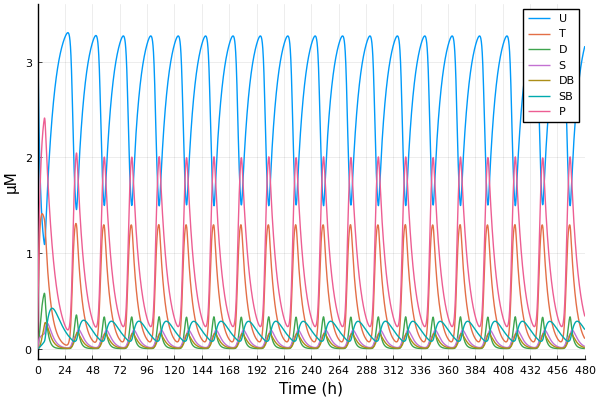

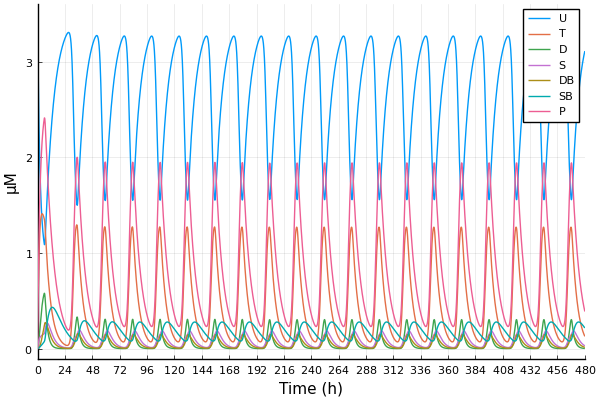

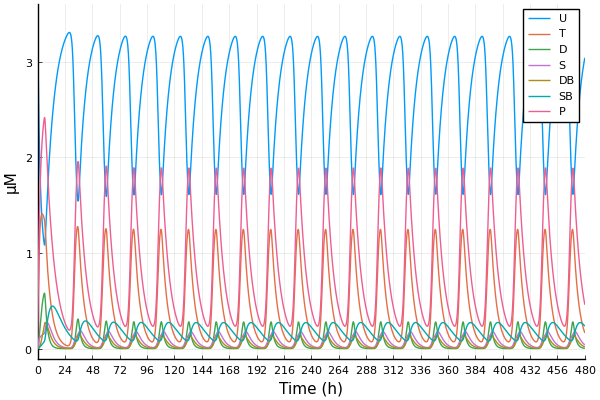

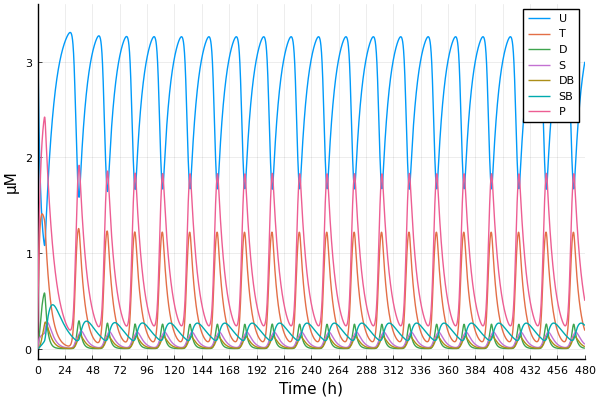

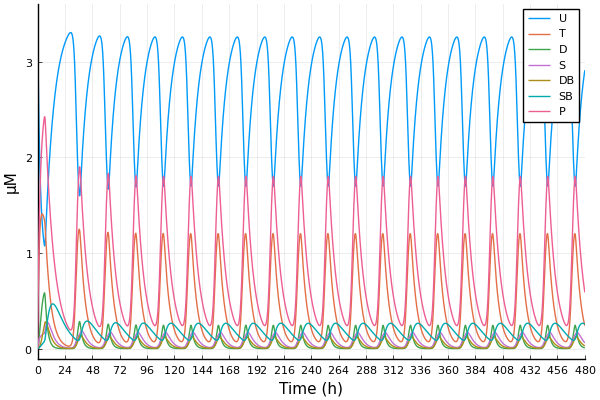

...

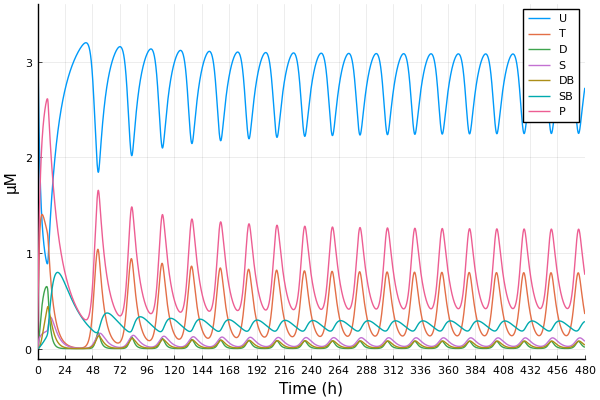

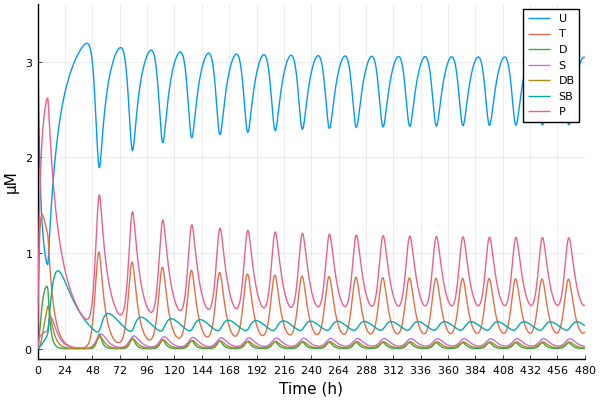

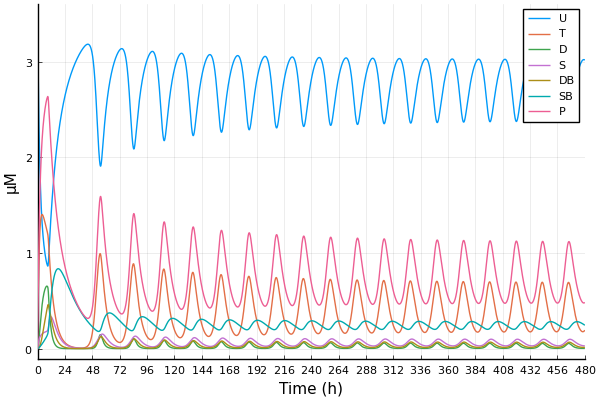

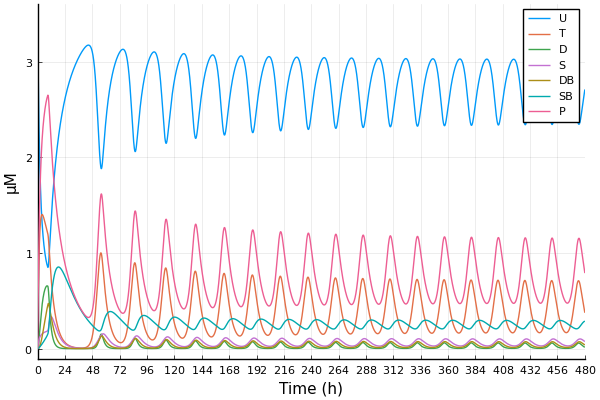

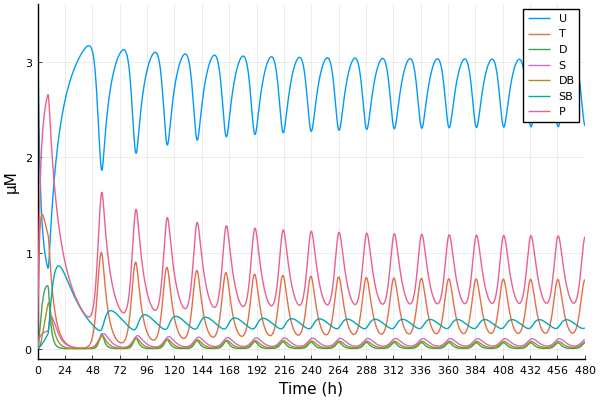

LoadError: UndefRefError: access to undefined reference

In [43]:
# Make traces for each of the pairs of parameters along the contour
plots = Array{Any}(undef,length(kSU_24), 1)

for i in 1:length(kSU_24)
    if isnan(kSU_24[i]) || isnan(κ_24[i])
        continue
    end
    
    # U, T, D, S, DB, SB
    p0 = [3.5, 0, 0, 0, 0, 0]
    
    p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_24[i], kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_ASB, κ_24[i], ν)

    tmax = 480

    prob = ODEProblem(kaiabc_phong_low_temp3!, p0, (0.0, tmax), p)
    sol = solve(prob, Tsit5(), saveat = 0.1)

    p_i = plot(sol, labels=["U" "T" "D" "S" "DB" "SB"])
    plot!(sol.t, 3.5*phospho_C(sol.u), label="P")
    xticks!(0:24:tmax)
    xlabel!("Time (h)")
    ylabel!("μM")

    plots[i, 1] = p_i
end

for plot in plots
    display(plot)
end

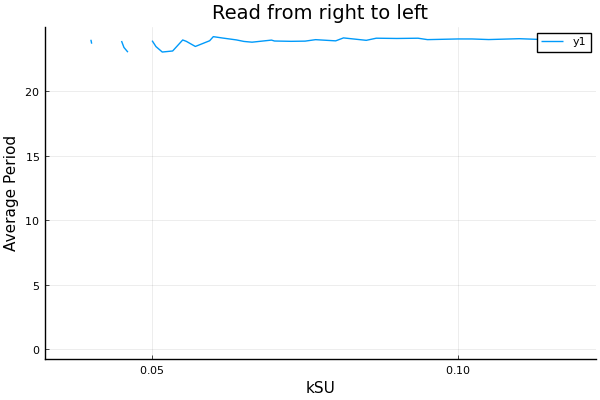

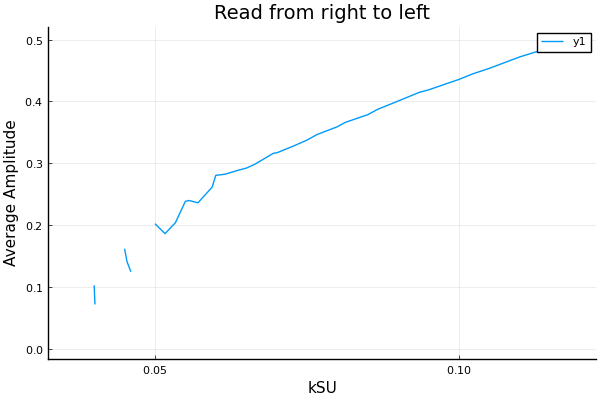

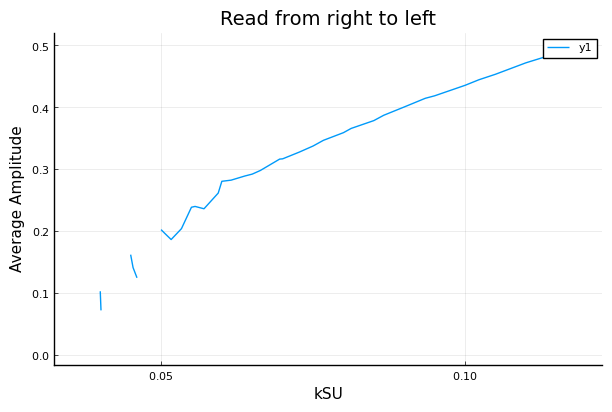

In [44]:
# Plots of average period, ampltiude and pC state over kSU
filtered_kSU_24 = filter(!isnan, kSU_24)

p_mean_per = plot(title = "Read from right to left", kSU_24, per_mat_after)
xticks!(0.0:0.05:maximum(filtered_kSU_24))
xlabel!("kSU")
ylabel!("Average Period")
display(p_mean_per)

p_mean_amp = plot(title = "Read from right to left", kSU_24, amp_mat_after)
xticks!(0.0:0.05:maximum(filtered_kSU_24))
xlabel!("kSU")
ylabel!("Average Amplitude")
display(p_mean_amp)

In [17]:
# Plots of average period, ampltiude and pC state over K_ASB

#=filtered_K_ASB_24 = filter(!isnan, K_ASB_24)

display("Note: sequestration strength of KaiBC for KaiA is greater at lower temperatures... K_ASB increases as you lower temperature")

p_mean_per = plot(title = "Read from left to right", K_ASB_24, per_mat_after)
xticks!(0.0:0.0005:maximum(filtered_K_ASB_24))
xlabel!("K_ASB")
ylabel!("Average Period")
display(p_mean_per)

p_mean_amp = plot(title = "Read from left to right", K_ASB_24, amp_mat_after)
xticks!(0.0:0.0005:maximum(filtered_K_ASB_24))
xlabel!("K_ASB")
ylabel!("Average Amplitude")
display(p_mean_amp)

p_mean_pC = plot(title = "Read from left to right", K_ASB_24, pC_mat_after)
xticks!(0.0:0.0005:maximum(filtered_K_ASB_24))
xlabel!("K_ASB")
ylabel!("Average Phosphorylated KaiC")=#

In [48]:
# Plots of average period, amplitude, and pC state over contour coordinates

# Find the length of the doubly filtered arrays
j = 0
for i in 1:length(kSU_24)
    if !isnan(kSU_24[i]) && !isnan(κ_24[i])
        j += 1
    else
        continue
    end
end

doubly_filtered_length = j
print(doubly_filtered_length)

# Doubly filter the arrays
k = 1
doubly_filtered_kSU_24 = kSU_24[1:doubly_filtered_length]
doubly_filtered_κ_24 = κ_24[1:doubly_filtered_length]
cont_distances = zeros(doubly_filtered_length,1)

kSU_changes = doubly_filtered_kSU_24[2:end]-doubly_filtered_kSU_24[1:end-1]
κ_changes = doubly_filtered_κ_24[2:end]-doubly_filtered_κ_24[1:end-1]
distances = @.sqrt(kSU_changes^2 + κ_changes^2)

cont_distance = 0
for i in 1:doubly_filtered_length
    if i == 1
        cont_distance = 0
        cont_distances[i,1] = cont_distance
    else

        cont_distance += distances[i-1,1]
        cont_distances[i,1] = cont_distance
    end
end    

p_mean_per = plot(title = "Read from left to right", cont_distances, per_mat_after[1:doubly_filtered_length])
xticks!(0.0:0.005:maximum(cont_distances))
xlabel!("Distance Along Contour")
ylabel!("Average Period")

# Add a single point using marker formatted as desired:
pt = (cont_distances[5], per_mat_after[5])
plot!(p_mean_per, [pt[1]],[pt[2]], markershape=:plus,
	markercolor=:red, markerstrokecolor=:black, markerstrokewidth=3,
	markersize=10
)

pt = (cont_distances[9], per_mat_after[9])
plot!(p_mean_per, [pt[1]],[pt[2]], markershape=:plus,
	markercolor=:blue, markerstrokecolor=:black, markerstrokewidth=3,
	markersize=10
)
display(p_mean_per)

p_mean_amp = plot(title = "Read from left to right", cont_distances, amp_mat_after[1:doubly_filtered_length])
xticks!(0.0:0.005:maximum(cont_distances))
xlabel!("Distance Along Contour")
ylabel!("Average Amplitude")

# Add a single point using marker formatted as desired:
pt = (cont_distances[5], amp_mat_after[5])
plot!(p_mean_amp, [pt[1]],[pt[2]], markershape=:plus,
	markercolor=:red, markerstrokecolor=:black, markerstrokewidth=3,
	markersize=10
)

pt = (cont_distances[9], amp_mat_after[9])
plot!(p_mean_amp, [pt[1]],[pt[2]], markershape=:plus,
	markercolor=:blue, markerstrokecolor=:black, markerstrokewidth=3,
	markersize=10
)
display(p_mean_amp)

p_mean_pC = plot(title = "Read from left to right", cont_distances, pC_mat_after[1:doubly_filtered_length])
xticks!(0.0:0.005:maximum(cont_distances))
xlabel!("Distance Along Contour")
ylabel!("Average Phosphorylated KaiC")

# Add a single point using marker formatted as desired:
pt = (cont_distances[5], pC_mat_after[5])
plot!(p_mean_pC, [pt[1]],[pt[2]], markershape=:plus,
	markercolor=:red, markerstrokecolor=:black, markerstrokewidth=3,
	markersize=10
)

pt = (cont_distances[9], pC_mat_after[9])
plot!(p_mean_pC, [pt[1]],[pt[2]], markershape=:plus,
	markercolor=:blue, markerstrokecolor=:black, markerstrokewidth=3,
	markersize=10
)
display(p_mean_pC)

# Plotting the contour again to show what point along the contour is what point along the average per, amp, and phos-KaiC curves
p5 = plot()
heatmap!(p5, kSU_vec, κ_vec, transpose(per_mat), xlabel="kSU", ylabel="κ", title = "Period")

cls = levels(contours(kSU_vec, κ_vec, per_mat, [24]))
isochrone = Dict()
cl = cls[1]
line = lines(cl)[1]

lvl = level(cl) # the z-value of this contour level
isochrone[lvl] = []

xs, ys = coordinates(line) # coordinates of this line segment
isochrone[lvl] = [isochrone[lvl]..., (xs, ys)]
scatter!(p5, xs, ys, label="$(lvl)", c=:blue) # pseuod-code; use whatever plotting package you prefer
plot!(p5, xs, ys, arrow=(:closed, 1.), label="$(lvl)", c=:blue)

# Add a single point using marker formatted as desired:
pt = (isochrone[24][1][1][5],isochrone[24][1][2][5]) #where to place the marker

plot!(p5, [pt[1]],[pt[2]], markershape=:plus,
	markercolor=:red, markerstrokecolor=:black, markerstrokewidth=3,
	markersize=10
)

pt = (isochrone[24][1][1][9],isochrone[24][1][2][9]) #where to place the marker

plot!(p5, [pt[1]],[pt[2]], markershape=:plus,
	markercolor=:blue, markerstrokecolor=:black, markerstrokewidth=3,
	markersize=10
)
display(p5)

37

LoadError: InexactError: trunc(Int64, NaN)

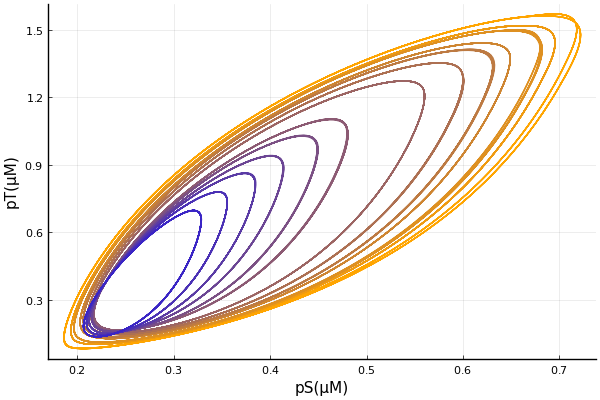

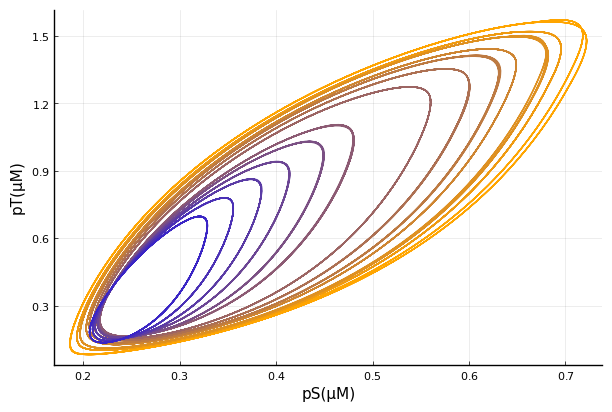

In [72]:
# master parameters
M_new = 6.

# constants
tmax = 480
istart = 3001

p1 = plot(legend=false)
#p2 = plot(legendtitle="M")

kSU_24 = isochrone[24][1][1]
K_SBA_24 = isochrone[24][1][2]

pal = palette(cgrad([:orange, :blue]), length(kSU_24))

for i in 1:2:length(kSU_24)
    
    if isnan(kSU_24[i]) || isnan(K_SBA_24[i])
        continue
    end
    
    P0 = [3.5, 0, 0, 0, 0, 0]
    
    p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_24[i], kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_SBA_24[i])

    prob = ODEProblem(kaiabc_phong_low_temp3!, P0, (0.0, tmax), p)
    sol = solve(prob, Tsit5(), saveat = 0.1)

    pS = sum(hcat(sol.u...)[[3, 4, 5, 6], :], dims=1)
    #pS = sum(hcat(sol.u...)[[6], :], dims=1)
    pT = sum(hcat(sol.u...)[[2, 3, 5], :], dims=1)

    plot!(p1, pS'[istart:end], pT'[istart:end],c=pal[i])
    #plot!(p2, sol.t, hcat(sol.u...)[6, :], label="$(M_new)")
    
end

xlabel!(p1, "pS(μM)")
ylabel!(p1, "pT(μM)")
display(p1)


## Exploring stoichiometry

In [73]:
function solve_SBA(Atot; M = 6., Kd = 1e-3, SB = 3.5)
    Delta = (M*SB + Atot + Kd)^2 - 4M*Atot*SB
    SBA = 1/(2M)*(M*SB + Atot + Kd - sqrt(Delta))
    return SBA
end

solve_SBA (generic function with 1 method)

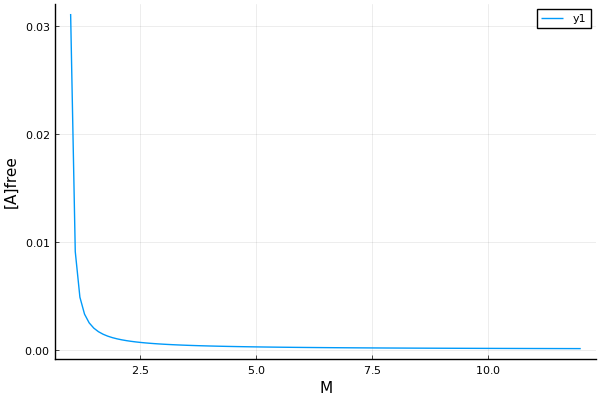

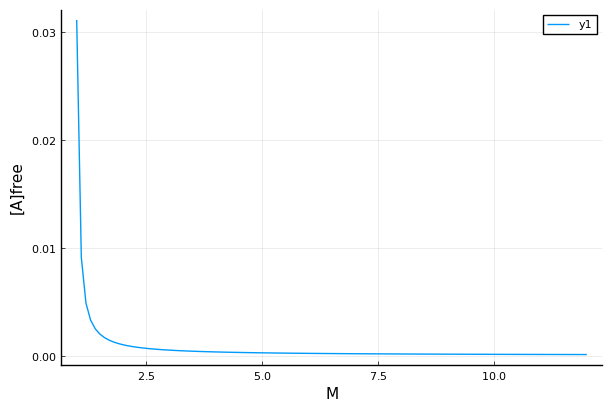

In [80]:
M_vec = 1:0.1:12.
Atot = 1.0

p1 = plot(M_vec, (m -> Atot - m*solve_SBA(Atot; M = m, SB = 1.)).(M_vec))
xlabel!("M")
ylabel!("[A]free")
display(p1)

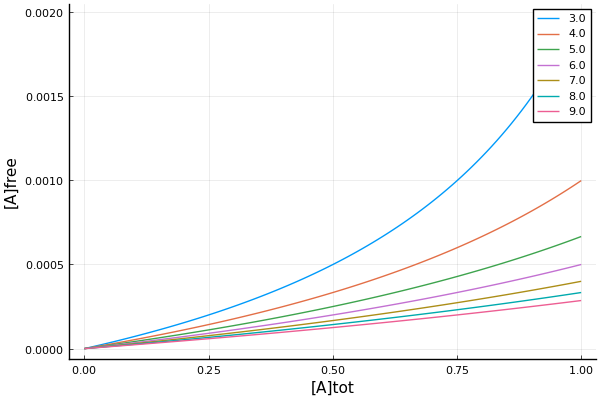

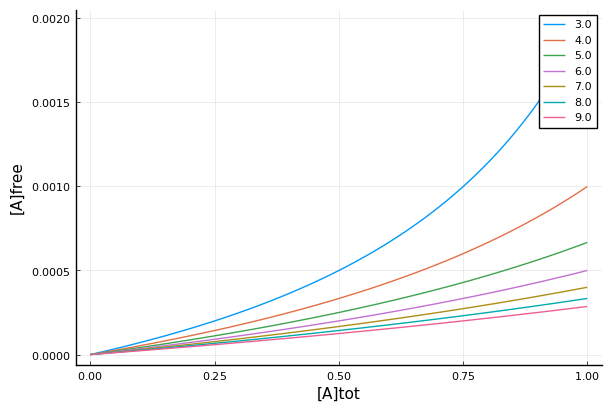

In [77]:
Atot_vec = 0:0.01:1.

M_vec = 3.:1.:9.

p1 = plot()
for M in M_vec
    plot!(Atot_vec, Atot_vec .- M*solve_SBA.(Atot_vec; M = M, SB = 0.5, Kd = 1e-3), label="$(M)")
end
xlabel!("[A]tot")
ylabel!("[A]free")

display(p1)

Experimentally we've shown that the $S \rightarrow U$ reaction is inhibited at low temperatures while $D \rightarrow S$ less so,
which hints accumulation of S species at low temperatures.
Since SB complex sequesters KaiA which is strictly required to phosphorylate KaiC, the accumulation of S is expected to delay KaiC phosphorylation which, overall, lengthens the period.

However, in terms of phenomenology we know that the period is compensated with varying temperatures.
There has to be one or more temperature dependent reactions that balance the period-lengthening effect of the slowed down
$S \rightarrow U$ step.


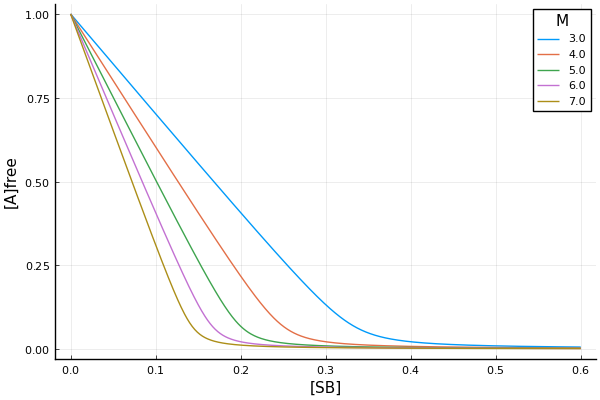

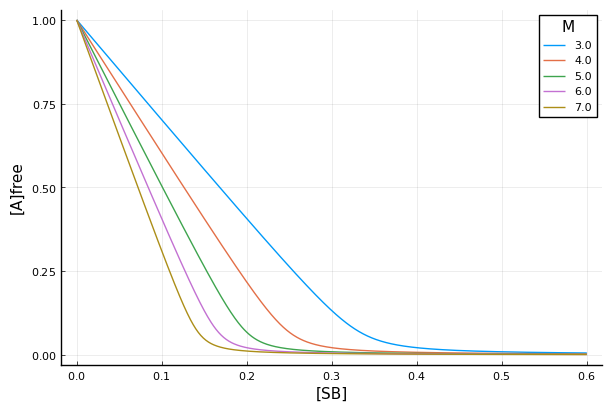

In [225]:
SB_vec = 0:0.001:0.6
Atot = 1.

M_vec = 3.:1.:7.

# p = plot(legendtitle = "M", xlim=(0.1, 0.65))
p = plot(legendtitle = "M")
for M in M_vec
    plot!(SB_vec, Atot .- M*(sb -> solve_SBA(Atot; M = M, SB = sb, Kd = 0.005)).(SB_vec), label="$(M)")
end
xlabel!("[SB]")
ylabel!("[A]free")

display(p)

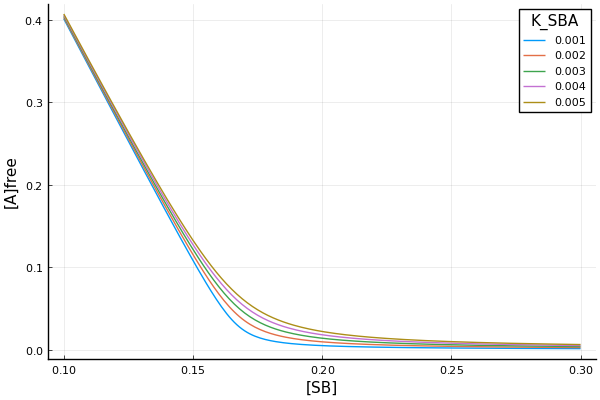

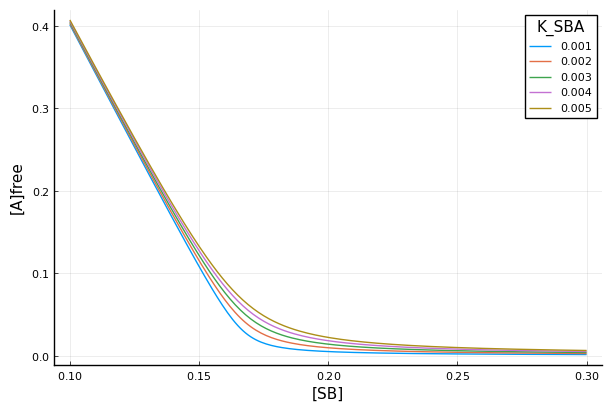

In [227]:
SB_vec = 0.1:0.001:0.3
Atot = 1.

K_SBA_vec = 1e-3:1e-3:5e-3
# K_SBA_vec = 4e-4:2e-4:1.2e-3

p = plot(legendtitle = "K_SBA")
# p = plot(legendtitle = "K_SBA", xlim=(0.12, 0.3))
for K_SBA in K_SBA_vec
    plot!(SB_vec, Atot .- M*(sb -> solve_SBA(Atot; M = 6., SB = sb, Kd = K_SBA)).(SB_vec), label="$(K_SBA)")
end
xlabel!("[SB]")
ylabel!("[A]free")

display(p)

The Murayama 2017 paper shows that as temperature decreases, though the amplitude also decreases, the mean phosphorylation level is largely unaffected (from $30^\circ C$ all the way to 16. Phosphorylation level goes up at 10).

Is it true in the model either with varying $M$ or varying $K_{SBA}$?

In [81]:
kSU_vec = 0.02:0.004:0.12
M_vec = 2.:0.3:8.

# additional params
A0 = 1.0
fATP = 1.0

# KaiBC-KaiA binding stoichiometry
K_SBA = 0.002

# find period numerically
per_mat = zeros(length(kSU_vec), length(M_vec))
amp_mat = zeros(length(kSU_vec), length(M_vec))
pC_mat = zeros(length(kSU_vec), length(M_vec))

for (i, kSU_cold) in enumerate(kSU_vec)
    for (j, M_new) in enumerate(M_vec)
        # initial conditions
        u0 = [3.5, 0, 0, 0, 0, 0]
        
        p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_cold, kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_SBA)
        
        conv_t, amplitude, per, phase = 
        attracted_to(kaiabc_phong_low_temp3!, u0, 168, p; 
        burnin=96, conv_tol=5e-2, amp_cutoff=5e-2, tmax_stop=1e3)

        per_mat[i, j] = per == -1 ? NaN : per
        amp_mat[i, j] = amplitude == -1 ? NaN : amplitude
        
        # solve it one more time to get mean fraction of pC
        prob = ODEProblem(kaiabc_phong_low_temp3!, u0, (0.0, conv_t + 1000.), p)
        sol = solve(prob, reltol=1e-8, abstol=1e-8)
        mean_pC = conv_t < 0 ? NaN : mean(phospho_C(sol.u[sol.t .> conv_t]))
        
        pC_mat[i, j] = mean_pC
        
        print("kSU=$(kSU_cold); M=$(M_new); amp=$(amplitude); per=$(per); pC=$(mean_pC)\n")
    end
end

kSU=0.02; M=2.0; amp=-1; per=-1; pC=NaN
kSU=0.02; M=2.3; amp=-1; per=-1; pC=0.3263812047288559
kSU=0.02; M=2.6; amp=-1; per=-1; pC=0.3168841724331472
kSU=0.02; M=2.9; amp=-1; per=-1; pC=0.3080035223606055
kSU=0.02; M=3.2; amp=-1; per=-1; pC=0.2998405669748937
kSU=0.02; M=3.5; amp=-1; per=-1; pC=0.29121670172891817
kSU=0.02; M=3.8; amp=-1; per=-1; pC=0.2810533261141835
kSU=0.02; M=4.1; amp=-1; per=-1; pC=0.278270082916181
kSU=0.02; M=4.4; amp=-1; per=-1; pC=0.27077070846834084
kSU=0.02; M=4.7; amp=-1; per=-1; pC=0.26052882018501067
kSU=0.02; M=5.0; amp=-1; per=-1; pC=0.25929828543726174
kSU=0.02; M=5.3; amp=-1; per=-1; pC=NaN
kSU=0.02; M=5.6; amp=-1; per=-1; pC=NaN
kSU=0.02; M=5.9; amp=-1; per=-1; pC=NaN
kSU=0.02; M=6.2; amp=-1; per=-1; pC=NaN
kSU=0.02; M=6.5; amp=-1; per=-1; pC=NaN
kSU=0.02; M=6.8; amp=-1; per=-1; pC=NaN
kSU=0.02; M=7.1; amp=-1; per=-1; pC=NaN
kSU=0.02; M=7.4; amp=-1; per=-1; pC=NaN
kSU=0.02; M=7.7; amp=-1; per=-1; pC=NaN
kSU=0.02; M=8.0; amp=-1; per=-1; pC=NaN
kSU=0.0

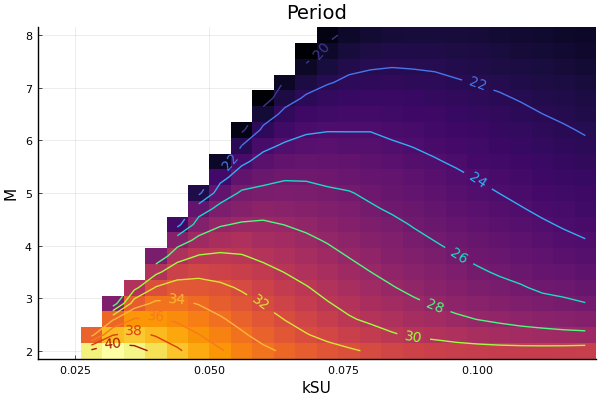

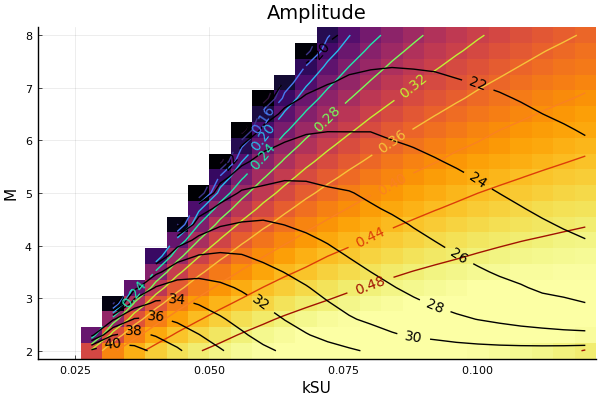

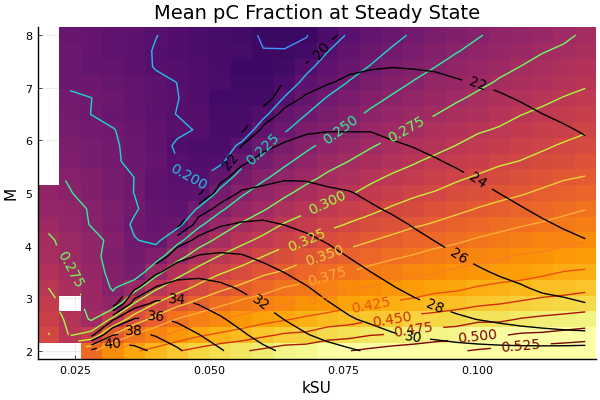

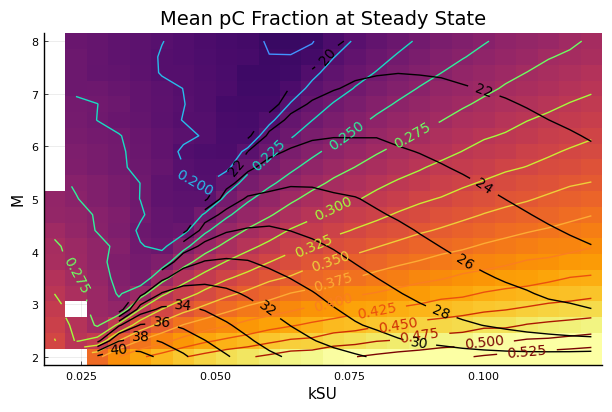

In [82]:
p1 = heatmap(kSU_vec, M_vec, transpose(per_mat), xlabel="kSU", ylabel="M", title = "Period")

contour!(p1, ones(length(M_vec))*kSU_vec',
    M_vec*ones(length(kSU_vec))', 
    transpose(per_mat), 
    levels=14, color=:turbo, clabels=true, cbar=false, lw=1)

display(p1)

p2 = heatmap(kSU_vec, M_vec, transpose(amp_mat), xlabel="kSU", ylabel="M", title = "Amplitude")

contour!(ones(length(M_vec))*kSU_vec',
    M_vec*ones(length(kSU_vec))', 
    transpose(amp_mat), 
    levels=14, color=:turbo, clabels=true, cbar=false,
    lw=1, clims=(0.1, 0.5))

contour!(p2, ones(length(M_vec))*kSU_vec',
    M_vec*ones(length(kSU_vec))', 
    transpose(per_mat), 
    levels=14, clabels=true, color=[:black], lw=1)

display(p2)

p3 = heatmap(kSU_vec, M_vec, transpose(pC_mat), xlabel="kSU", ylabel="M", title = "Mean pC Fraction at Steady State")

contour!(ones(length(M_vec))*kSU_vec',
    M_vec*ones(length(kSU_vec))', 
    transpose(pC_mat), 
    levels=14, color=:turbo, clabels=true, cbar=false, 
    lw=1, clims=(0.1, 0.5))

contour!(p3, ones(length(M_vec))*kSU_vec',
    M_vec*ones(length(kSU_vec))', 
    transpose(per_mat), 
    levels=14, clabels=true, color=[:black], lw=1)


display(p3)

Extract contour coordinates

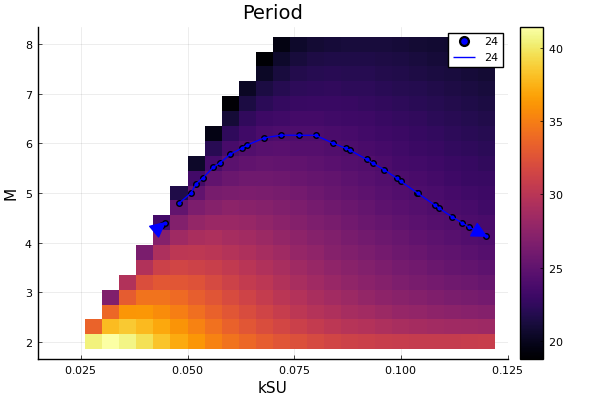

sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


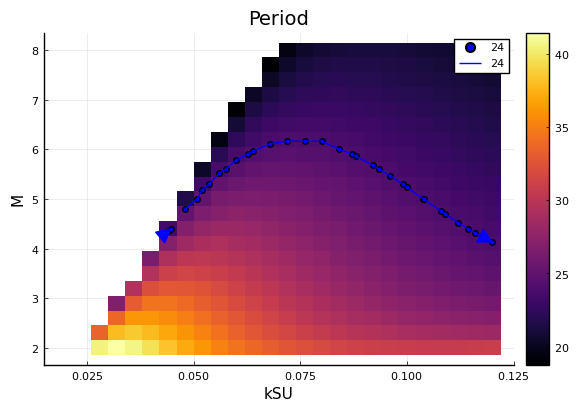

In [83]:
p4 = plot()
heatmap!(p4, kSU_vec, M_vec, transpose(per_mat), xlabel="kSU", ylabel="M", title = "Period")

cls = levels(contours(kSU_vec, M_vec, per_mat, [24]))
isochrone = Dict()
for cl in cls
    lvl = level(cl) # the z-value of this contour level
    isochrone[lvl] = []
    for line in lines(cl)
        xs, ys = coordinates(line) # coordinates of this line segment
        isochrone[lvl] = [isochrone[lvl]..., (xs, ys)]
        scatter!(p4, xs, ys, label="$(lvl)", c=:blue) # pseuod-code; use whatever plotting package you prefer
        plot!(p4, xs, ys, arrow=(:closed, 1.), label="$(lvl)", c=:blue)
    end
end

display(p4)

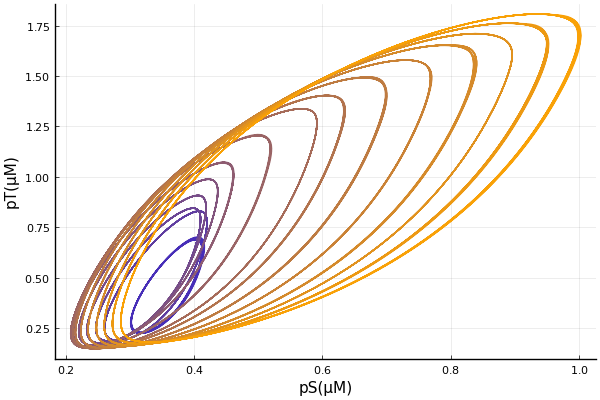

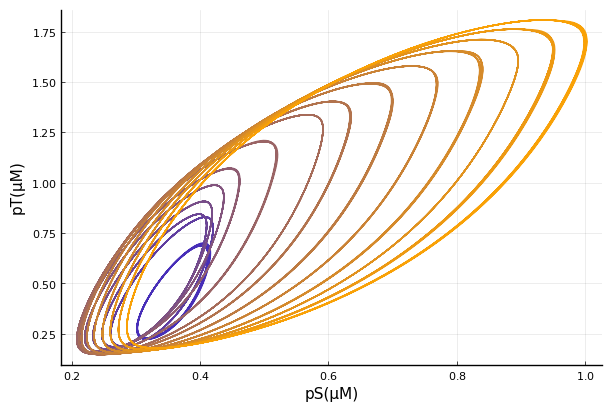

In [86]:
# master parameters
K_SBA = 0.002

# constants
tmax = 480
istart = 3001

p1 = plot(legend=false)

kSU_24 = isochrone[24][1][1]
M_24 = isochrone[24][1][2]

pal = palette(cgrad([:blue, :orange]), length(kSU_24))

for i in 1:2:length(kSU_24)
    
    if isnan(kSU_24[i]) || isnan(M_24[i])
        continue
    end
    
    P0 = [3.5, 0, 0, 0, 0, 0]
    
    p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_24[i], kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_24[i], K_SBA)

    prob = ODEProblem(kaiabc_phong_low_temp3!, P0, (0.0, tmax), p)
    sol = solve(prob, Tsit5(), saveat = 0.1)

    pS = sum(hcat(sol.u...)[[3, 4, 5, 6], :], dims=1)
    #pS = sum(hcat(sol.u...)[[6], :], dims=1)
    pT = sum(hcat(sol.u...)[[2, 3, 5], :], dims=1)

    plot!(p1, pS'[istart:end], pT'[istart:end],c=pal[i])
    
end

xlabel!(p1, "pS(μM)")
ylabel!(p1, "pT(μM)")
display(p1)


Limit cycle in the pS-pT space as M or Kd changes

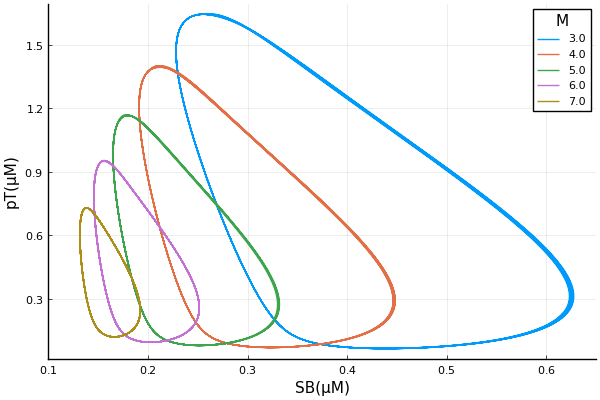

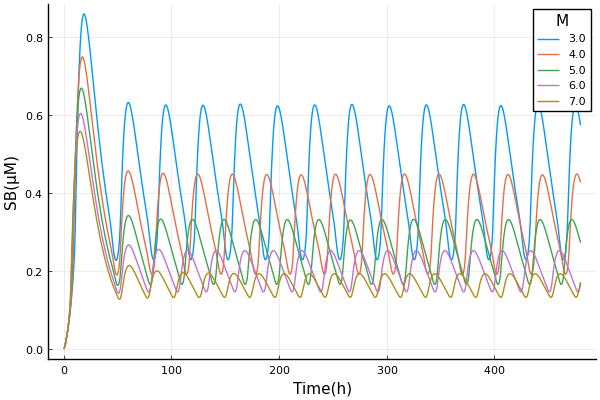

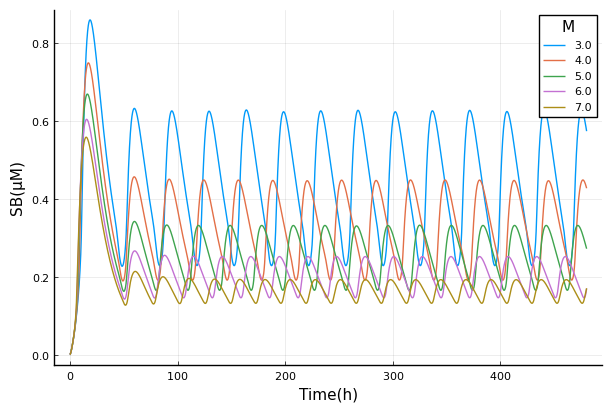

In [39]:
# master parameters
K_SBA = 0.001
M_new = 6.
kSU_new = 0.05

# Vary M
M_vec = 3.:1.:7.

# constants
tmax = 480
istart = 2001

p1 = plot(legendtitle="M", xlim=(0.1, 0.65))
p2 = plot(legendtitle="M")
for M_new in M_vec
    
    P0 = [3.5, 0, 0, 0, 0, 0]
    
    p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_new, kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_SBA)

    prob = ODEProblem(kaiabc_phong_low_temp3!, P0, (0.0, tmax), p)
    sol = solve(prob, Tsit5(), saveat = 0.1)

    #pS = sum(hcat(sol.u...)[[3, 4, 5, 6], :], dims=1)
    pS = sum(hcat(sol.u...)[[6], :], dims=1)
    pT = sum(hcat(sol.u...)[[2, 3, 5], :], dims=1)

    plot!(p1, pS'[istart:end], pT'[istart:end], label="$(M_new)")
    plot!(p2, sol.t, hcat(sol.u...)[6, :], label="$(M_new)")
    
end

xlabel!(p1, "SB(μM)")
ylabel!(p1, "pT(μM)")
display(p1)

xlabel!(p2, "Time(h)")
ylabel!(p2, "SB(μM)")
display(p2)

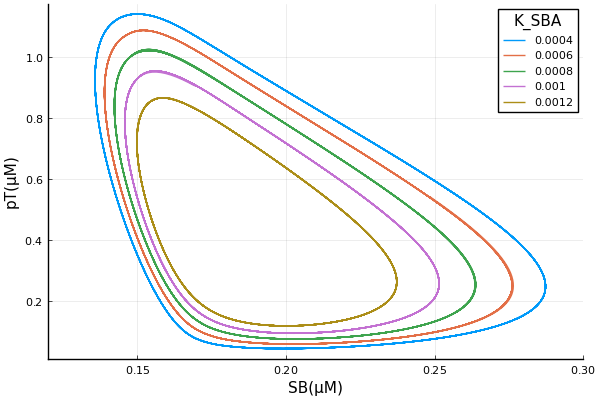

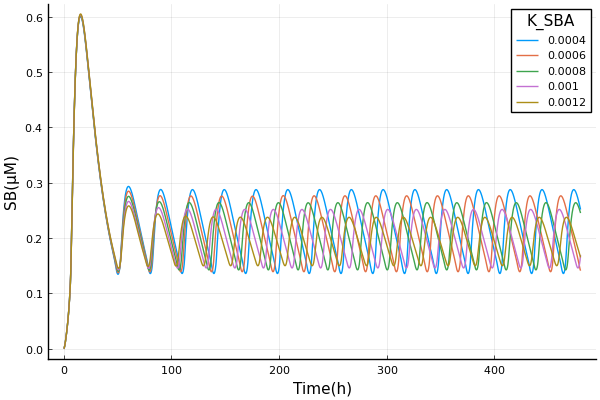

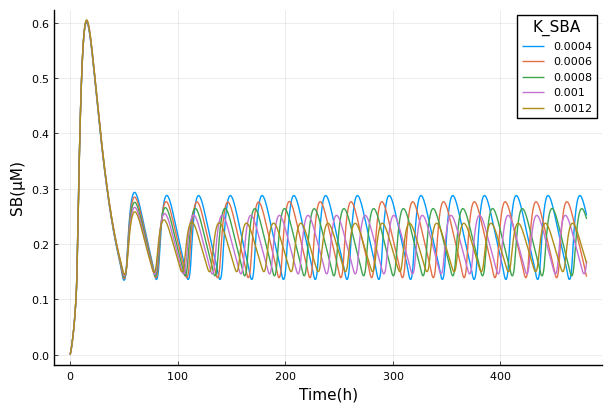

In [40]:
# master parameters
K_SBA = 0.001
M_new = 6.
kSU_new = 0.05

# Vary Kd
K_SBA_vec = 4e-4:2e-4:1.2e-3

# constants
tmax = 480
istart = 2001

p1 = plot(legendtitle="K_SBA", xlim=(0.12, 0.3))
p2 = plot(legendtitle="K_SBA")
for K_SBA in K_SBA_vec
    
    P0 = [3.5, 0, 0, 0, 0, 0]
    
    p = (kUTA, kTU, kTUA, kTDA, kDT, kDTA, kDS, kDSA, kSDA, kSU_new, kSUA, kUSA, kCIhyd,
        KA, A0, fATP, 0., M_new, K_SBA)

    prob = ODEProblem(kaiabc_phong_low_temp3!, P0, (0.0, tmax), p)
    sol = solve(prob, Tsit5(), saveat = 0.1)

    #pS = sum(hcat(sol.u...)[[3, 4, 5, 6], :], dims=1)
    pS = sum(hcat(sol.u...)[[6], :], dims=1)
    pT = sum(hcat(sol.u...)[[2, 3, 5], :], dims=1)

    plot!(p1, pS'[istart:end], pT'[istart:end], label="$(K_SBA)")
    plot!(p2, sol.t, hcat(sol.u...)[6, :], label="$(K_SBA)")
    
end

xlabel!(p1, "SB(μM)")
ylabel!(p1, "pT(μM)")
display(p1)

xlabel!(p2, "Time(h)")
ylabel!(p2, "SB(μM)")
display(p2)